In [ ]:
!unzip datasets.zip


Archive:  datasets.zip
  inflating: datasets/classes.txt    
   creating: datasets/images/
  inflating: datasets/images/07c83b01-K_0115.jpg  
  inflating: datasets/images/0c01c70b-Comma_0296.jpg  
  inflating: datasets/images/0cb6ba04-K_0161.jpg  
  inflating: datasets/images/130c451e-M_0165.jpg  
  inflating: datasets/images/142f7434-J_0155.jpg  
  inflating: datasets/images/161a8532-N_0166.jpg  
  inflating: datasets/images/1662326e-H_0153.jpg  
  inflating: datasets/images/17098d14-Y_0183.jpg  
  inflating: datasets/images/1a677665-I_0112.jpg  
  inflating: datasets/images/1ae35daf-D_0194.jpg  
  inflating: datasets/images/1b7af65d-G_0152.jpg  
  inflating: datasets/images/1e4a5ed9-Decimal_0304.jpg  
  inflating: datasets/images/1fec7a85-Z_0132.jpg  
  inflating: datasets/images/200b1356-J_0139.jpg  
  inflating: datasets/images/20d28b20-R_0122.jpg  
  inflating: datasets/images/21486597-H_0111.jpg  
  inflating: datasets/images/25ff3ac3-F_0150.jpg  
  inflating: datasets/images/27d

In [ ]:
!pip install torch torchvision torchaudio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 62.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 47.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 86.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 73.1 MB/s eta 0:00:00


In [1]:
!pip install ultralytics

In [2]:
from ultralytics import YOLO

In [7]:
model = YOLO("C:\\Users\\HP\\OneDrive\\Documents\\object-detection\\sign-language-detection\\IslandSigns-app\\back-end\\env\\CustomModel_v9.pt")  # load a pretrained model (recommended for training)

AttributeError: Can't get attribute 'RepNCSPELAN4' on <module 'ultralytics.nn.modules.block' from 'C:\\Users\\HP\\anaconda3\\Lib\\site-packages\\ultralytics\\nn\\modules\\block.py'>

In [3]:
results = model("C:\\Users\\HP\\OneDrive\\Documents\\object-detection\\sign-language-detection\\IslandSigns-app\\back-end\\env\\decoded_image.png")


image 1/1 C:\Users\HP\OneDrive\Documents\object-detection\sign-language-detection\IslandSigns-app\back-end\env\decoded_image.png: 480x640 (no detections), 702.1ms
Speed: 10.0ms preprocess, 702.1ms inference, 10.0ms postprocess per image at shape (1, 3, 480, 640)


In [42]:
arr=[]
conf_scores=[]
for detection in results[0]:

    class_index = detection.boxes # Get the class index of the detection
    class_name = detection.names  # Get the name of the detection

    tensor_idx = class_index.cls
    conf_score = class_index.conf
    arr.append(class_name[ tensor_idx.item()])
    conf_scores.append(conf_score)

result={
    'speaker':'customer',
    'prediction':arr,
    'conf_scores':conf_scores
}
print(result)


{'speaker': 'customer', 'prediction': ['B'], 'conf_scores': [tensor([0.6013])]}


In [ ]:
from PIL import Image

for r in results:
    im_array = r.plot()  # plot a BGR numpy array of predictions
    im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
    display(im)  # show image

In [ ]:
# Train the model
results = model.train(data='/content/custom.yaml', batch=42, epochs=150, imgsz=640)

Ultralytics YOLOv8.1.31 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/CustomModel_v1.pt, data=/content/custom.yaml, epochs=150, time=None, patience=100, batch=42, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

100%|██████████| 755k/755k [00:00<00:00, 83.8MB/s]


Overriding model.yaml nc=26 with nc=36

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 6.23M/6.23M [00:00<00:00, 54.9MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/labels... 176 images, 0 backgrounds, 0 corrupt: 100%|██████████| 176/176 [00:00<00:00, 1245.67it/s]

train: New cache created: /content/datasets/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/datasets/labels.cache... 176 images, 0 backgrounds, 0 corrupt: 100%|██████████| 176/176 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00025, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.00065625), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      6.37G      2.152      5.812      1.952         17        640: 100%|██████████| 5/5 [01:00<00:00, 12.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:08<00:00,  2.95s/it]

                   all        176        176   0.000154     0.0264   0.000132   5.61e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      6.18G       2.24      5.857      2.017         17        640: 100%|██████████| 5/5 [00:30<00:00,  6.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:32<00:00, 10.94s/it]

                   all        176        176   0.000162     0.0194    0.00012   4.16e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      6.18G      2.101      5.662      1.896         15        640: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:43<00:00, 14.46s/it]

                   all        176        176   0.000344     0.0491   0.000388   0.000159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      6.19G      1.949      5.638      1.814         13        640: 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:41<00:00, 13.88s/it]

                   all        176        176   0.000266     0.0417    0.00611   0.000844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      6.18G       1.81      5.308      1.656         15        640: 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:42<00:00, 14.18s/it]

                   all        176        176    0.00161      0.103    0.00282    0.00169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      6.18G      1.744      5.125      1.564         16        640: 100%|██████████| 5/5 [00:03<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:36<00:00, 12.31s/it]


                   all        176        176    0.00376      0.148    0.00526    0.00311

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      6.18G      1.606      4.963      1.463         18        640: 100%|██████████| 5/5 [00:02<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.98s/it]

                   all        176        176     0.0164      0.146     0.0137    0.00919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      6.18G      1.468      4.646      1.376         16        640: 100%|██████████| 5/5 [00:02<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:40<00:00, 13.50s/it]

                   all        176        176       0.02      0.208     0.0254     0.0158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      6.14G      1.461       4.65      1.361         18        640: 100%|██████████| 5/5 [00:03<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.26s/it]

                   all        176        176      0.025      0.309     0.0443     0.0297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      6.14G      1.396      4.363      1.298         17        640: 100%|██████████| 5/5 [00:03<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.81s/it]


                   all        176        176     0.0365      0.477      0.095     0.0727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      6.14G       1.36      4.203      1.252         17        640: 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.59s/it]

                   all        176        176     0.0297      0.648      0.143      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      6.14G      1.323      3.904      1.192         15        640: 100%|██████████| 5/5 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.30s/it]

                   all        176        176      0.708     0.0623      0.166      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      6.14G      1.285      3.981      1.221         13        640: 100%|██████████| 5/5 [00:02<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.31s/it]

                   all        176        176      0.737      0.141      0.198      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      6.14G      1.181      3.645      1.172         20        640: 100%|██████████| 5/5 [00:03<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.62s/it]

                   all        176        176       0.67       0.17      0.223       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      6.14G      1.073       3.62      1.105         18        640: 100%|██████████| 5/5 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.03s/it]

                   all        176        176      0.679      0.245      0.261       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      6.14G      1.133      3.559      1.123         18        640: 100%|██████████| 5/5 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.64s/it]


                   all        176        176      0.761      0.248      0.314      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      6.14G      1.061      3.336      1.102         13        640: 100%|██████████| 5/5 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:36<00:00, 12.17s/it]

                   all        176        176      0.712      0.311      0.357      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      6.14G      1.038      3.138      1.102         19        640: 100%|██████████| 5/5 [00:02<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.66s/it]


                   all        176        176      0.727      0.328      0.394      0.322

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      6.14G      1.086      3.306      1.101         15        640: 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.39s/it]

                   all        176        176      0.659      0.403      0.452      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      6.15G       1.01      3.055      1.073         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.76s/it]


                   all        176        176      0.723      0.403      0.473        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      6.14G     0.9394       2.96      1.033         14        640: 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.57s/it]

                   all        176        176      0.676      0.439      0.504      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      6.15G       1.01      2.943      1.071         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.58s/it]


                   all        176        176      0.662        0.5      0.537      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      6.14G      1.015      2.727      1.075         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.56s/it]

                   all        176        176      0.747      0.436      0.552      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      6.15G     0.9751      2.767      1.061         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.79s/it]


                   all        176        176      0.729      0.453      0.581      0.496

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      6.14G     0.8899      2.589     0.9962         13        640: 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.90s/it]

                   all        176        176      0.808      0.442      0.604      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      6.15G     0.9656      2.719      1.032         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.43s/it]


                   all        176        176      0.643       0.54      0.626      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      6.14G     0.9426      2.626      1.041         13        640: 100%|██████████| 5/5 [00:02<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.71s/it]

                   all        176        176      0.652      0.544      0.648      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      6.15G     0.9614      2.633      1.044         19        640: 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.59s/it]

                   all        176        176      0.759      0.554      0.689      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      6.14G     0.8734      2.522      1.009         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.62s/it]

                   all        176        176      0.766      0.579      0.688      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      6.15G     0.9872      2.455      1.027         20        640: 100%|██████████| 5/5 [00:02<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.97s/it]


                   all        176        176      0.632      0.623      0.713      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      6.14G      0.917      2.366          1         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.67s/it]

                   all        176        176      0.721      0.609      0.727      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      6.15G     0.9106      2.398      1.039         16        640: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.69s/it]

                   all        176        176      0.645      0.672      0.754      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      6.14G     0.7932      2.266     0.9504         16        640: 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.67s/it]

                   all        176        176      0.675      0.669      0.765      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      6.16G     0.8601      2.407      1.032         10        640: 100%|██████████| 5/5 [00:02<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.77s/it]


                   all        176        176      0.645      0.763      0.783      0.689

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      6.14G     0.8316      2.262      0.977         13        640: 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.38s/it]

                   all        176        176      0.694      0.722      0.783      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      6.15G     0.8959      2.303       1.03         16        640: 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.84s/it]


                   all        176        176      0.614       0.78      0.783      0.685

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      6.14G     0.8539      2.192      1.023         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.82s/it]

                   all        176        176      0.614      0.803      0.791      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      6.15G     0.8824      2.221     0.9893         16        640: 100%|██████████| 5/5 [00:02<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.76s/it]


                   all        176        176      0.664      0.776      0.804      0.712

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      6.14G     0.8424      2.057      1.008         13        640: 100%|██████████| 5/5 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:36<00:00, 12.29s/it]

                   all        176        176      0.745       0.74       0.81      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      6.15G     0.8063      2.028     0.9651         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.60s/it]

                   all        176        176      0.748      0.762      0.805       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      6.14G     0.7946      2.137     0.9798         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.61s/it]

                   all        176        176      0.709      0.782      0.818      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      6.15G     0.7904      2.106     0.9729         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.85s/it]


                   all        176        176      0.782       0.79      0.851      0.744

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      6.14G     0.8946      2.109      1.011         21        640: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.69s/it]

                   all        176        176      0.748        0.8      0.866      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      6.15G     0.8422      2.116     0.9843         18        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.83s/it]


                   all        176        176      0.847      0.757      0.864      0.769

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      6.14G     0.8077      2.047     0.9476         13        640: 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:36<00:00, 12.31s/it]

                   all        176        176      0.784      0.801      0.869      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      6.15G     0.8249       1.96     0.9712         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.79s/it]


                   all        176        176      0.825      0.795      0.883      0.785

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      6.14G     0.7606      1.954      0.947         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.55s/it]

                   all        176        176      0.819      0.792      0.875      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      6.15G     0.7535      1.815     0.9288         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.71s/it]


                   all        176        176       0.81      0.805      0.881      0.789

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      6.14G     0.7791      1.974     0.9859         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.85s/it]

                   all        176        176      0.845      0.822      0.895      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      6.15G     0.7957       1.83     0.9656         20        640: 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.39s/it]


                   all        176        176      0.788      0.852       0.91      0.813

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      6.14G     0.7219      1.786     0.9149         20        640: 100%|██████████| 5/5 [00:02<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.48s/it]

                   all        176        176       0.78       0.87      0.908      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      6.15G     0.7827      1.851     0.9597         13        640: 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.70s/it]


                   all        176        176      0.771      0.893      0.908      0.809

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      6.14G     0.7454      1.729     0.9361         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.14s/it]

                   all        176        176      0.774      0.882      0.912      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      6.15G     0.7521      1.774     0.9477         13        640: 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.47s/it]

                   all        176        176      0.817      0.854      0.919      0.825



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      6.14G     0.7803      1.809     0.9665         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.56s/it]

                   all        176        176      0.849       0.84      0.925      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      6.15G     0.7326       1.73     0.9286         18        640: 100%|██████████| 5/5 [00:02<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.80s/it]


                   all        176        176      0.844      0.868      0.941      0.846

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      6.14G     0.7645      1.854     0.9419         18        640: 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.44s/it]

                   all        176        176      0.817      0.905      0.954      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      6.16G     0.7419       1.75     0.9478         17        640: 100%|██████████| 5/5 [00:02<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.68s/it]


                   all        176        176       0.88      0.906      0.958      0.862

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      6.14G     0.7573      1.794     0.9545         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.66s/it]

                   all        176        176      0.896      0.907      0.951       0.86



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      6.15G     0.7348      1.753     0.9346         18        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.77s/it]


                   all        176        176      0.817      0.914      0.941      0.854

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      6.14G     0.6866      1.626      0.919         16        640: 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.70s/it]

                   all        176        176      0.881      0.884      0.937      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      6.15G     0.7081      1.746     0.9404         17        640: 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.95s/it]

                   all        176        176      0.897      0.875      0.936      0.846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      6.14G     0.6612      1.579     0.9195         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.55s/it]

                   all        176        176      0.909      0.864      0.934      0.848



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      6.15G     0.6791      1.618     0.8989         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.37s/it]


                   all        176        176      0.902      0.848       0.93      0.841

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      6.14G     0.7118      1.627     0.9237         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.71s/it]

                   all        176        176      0.847      0.857      0.924      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      6.16G     0.6811      1.567     0.9217         13        640: 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.45s/it]


                   all        176        176      0.878      0.858       0.92      0.832

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      6.14G     0.7062      1.606     0.9151         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.83s/it]

                   all        176        176      0.834      0.854      0.921      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      6.16G     0.6436      1.672     0.8911         13        640: 100%|██████████| 5/5 [00:02<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.75s/it]


                   all        176        176      0.924      0.813      0.936      0.854

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      6.14G      0.689       1.53     0.9147         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.92s/it]

                   all        176        176      0.894      0.859      0.941       0.86



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      6.15G     0.7153      1.564      0.929         20        640: 100%|██████████| 5/5 [00:02<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.43s/it]


                   all        176        176      0.889      0.886      0.951      0.871

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      6.14G     0.6932      1.627     0.9493         16        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.59s/it]

                   all        176        176      0.891      0.885      0.977      0.887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      6.15G     0.6576      1.736      0.926         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.75s/it]


                   all        176        176      0.864      0.918      0.973      0.883

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      6.14G     0.6774      1.522     0.9235         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.66s/it]

                   all        176        176      0.866       0.92      0.975      0.889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      6.15G     0.7028      1.581     0.9041         19        640: 100%|██████████| 5/5 [00:03<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.44s/it]


                   all        176        176      0.882      0.909      0.973      0.891

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      6.14G     0.7056       1.54     0.9098         21        640: 100%|██████████| 5/5 [00:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.69s/it]

                   all        176        176      0.876      0.908      0.947      0.867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      6.15G     0.6681      1.551     0.9145         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.90s/it]


                   all        176        176      0.899      0.885      0.946       0.87

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      6.14G     0.7189      1.571     0.9701         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.79s/it]

                   all        176        176      0.919      0.881      0.949      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      6.15G     0.7543      1.552     0.9223         25        640: 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.61s/it]

                   all        176        176      0.884      0.901      0.957      0.879



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      6.14G     0.6597      1.574     0.9071         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.83s/it]

                   all        176        176      0.851      0.948       0.97      0.892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      6.15G     0.7159      1.631     0.9614         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.77s/it]


                   all        176        176      0.837      0.952       0.97      0.889

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      6.14G     0.7179      1.544     0.9284         18        640: 100%|██████████| 5/5 [00:02<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.87s/it]

                   all        176        176      0.878      0.933      0.975      0.896



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      6.16G     0.7125      1.477     0.9314         12        640: 100%|██████████| 5/5 [00:03<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.60s/it]

                   all        176        176      0.874      0.936      0.993      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      6.14G     0.6745      1.519     0.9039         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.34s/it]

                   all        176        176      0.885      0.936      0.977      0.897



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      6.15G     0.6814      1.521     0.8996         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.65s/it]

                   all        176        176      0.899      0.925      0.973      0.889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      6.14G     0.6361      1.429     0.9019         15        640: 100%|██████████| 5/5 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.66s/it]

                   all        176        176      0.892      0.929      0.977        0.9



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      6.15G     0.6666      1.529     0.9045         12        640: 100%|██████████| 5/5 [00:03<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.80s/it]

                   all        176        176      0.882       0.93      0.979      0.905



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      6.14G     0.6289      1.404     0.8906         19        640: 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.67s/it]

                   all        176        176      0.888      0.933      0.977      0.903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      6.16G     0.6435      1.417     0.9073         10        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.74s/it]

                   all        176        176      0.881      0.927      0.971      0.897



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      6.14G     0.7197       1.54     0.9383         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.75s/it]

                   all        176        176       0.89      0.935      0.967      0.892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      6.15G     0.6766      1.402     0.8983         15        640: 100%|██████████| 5/5 [00:02<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.70s/it]


                   all        176        176      0.895      0.934      0.967      0.888

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      6.14G     0.7133      1.478     0.9183         13        640: 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.72s/it]

                   all        176        176      0.886      0.931      0.962      0.889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      6.16G      0.654      1.413     0.9179         13        640: 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.82s/it]


                   all        176        176      0.921      0.893      0.959      0.885

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      6.14G     0.6682      1.387     0.8822         20        640: 100%|██████████| 5/5 [00:02<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.52s/it]

                   all        176        176      0.923      0.894       0.96       0.89



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      6.16G     0.6433      1.476     0.8724          8        640: 100%|██████████| 5/5 [00:02<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.44s/it]


                   all        176        176      0.918      0.902       0.97      0.897

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      6.14G     0.6387      1.474      0.898         20        640: 100%|██████████| 5/5 [00:02<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.75s/it]

                   all        176        176      0.903      0.921      0.972      0.894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      6.16G      0.694      1.423     0.9424         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.57s/it]

                   all        176        176      0.923      0.915      0.986      0.908



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      6.14G     0.6638       1.44     0.8906         18        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.73s/it]

                   all        176        176      0.922      0.916      0.969      0.892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      6.15G     0.6264       1.36     0.9023         16        640: 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.60s/it]


                   all        176        176      0.879       0.92      0.965      0.891

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      6.14G     0.6781       1.43     0.9309         14        640: 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.00s/it]

                   all        176        176      0.879      0.921       0.96       0.89



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      6.15G     0.6625      1.369     0.9117         19        640: 100%|██████████| 5/5 [00:02<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.54s/it]


                   all        176        176      0.876      0.921      0.958      0.889

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      6.14G      0.635      1.469     0.8957         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.80s/it]

                   all        176        176       0.88      0.914      0.959       0.89



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      6.16G     0.6566      1.368     0.8973         13        640: 100%|██████████| 5/5 [00:02<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.54s/it]


                   all        176        176      0.923      0.902      0.965      0.901

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      6.14G     0.6818      1.369     0.9096         20        640: 100%|██████████| 5/5 [00:02<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.63s/it]

                   all        176        176      0.939      0.904       0.97      0.903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      6.15G     0.6391      1.327      0.911         19        640: 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.98s/it]


                   all        176        176      0.944      0.929      0.977      0.907

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      6.14G     0.6393      1.433     0.8983         16        640: 100%|██████████| 5/5 [00:02<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.55s/it]

                   all        176        176      0.953      0.926       0.99      0.918



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      6.15G     0.6428      1.373     0.9284         17        640: 100%|██████████| 5/5 [00:02<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.65s/it]


                   all        176        176      0.939      0.927      0.977      0.909

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      6.14G     0.6466      1.351        0.9         17        640: 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.76s/it]

                   all        176        176      0.918      0.936      0.977      0.912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      6.15G      0.623      1.307     0.8851         16        640: 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.83s/it]


                   all        176        176      0.912      0.933       0.98      0.912

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      6.14G     0.6345      1.463     0.9143          8        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.81s/it]

                   all        176        176      0.913      0.932       0.98      0.911



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      6.15G     0.6436      1.406     0.9142         14        640: 100%|██████████| 5/5 [00:02<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.69s/it]

                   all        176        176      0.916      0.929       0.98      0.912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      6.14G     0.6609      1.414      0.904         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.63s/it]

                   all        176        176      0.929      0.924       0.98      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      6.16G     0.5874       1.33      0.886         15        640: 100%|██████████| 5/5 [00:02<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.62s/it]

                   all        176        176      0.922      0.928       0.98      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      6.14G     0.6132      1.396     0.8855         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.04s/it]

                   all        176        176      0.913      0.932       0.98      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      6.16G     0.6042      1.358     0.8736         12        640: 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.51s/it]

                   all        176        176      0.908      0.938      0.979      0.919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      6.14G     0.6083      1.332     0.8855         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.72s/it]

                   all        176        176       0.92      0.937      0.979      0.921



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      6.16G     0.6242      1.373     0.8994         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.71s/it]


                   all        176        176      0.935      0.931      0.979       0.92

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      6.14G     0.6453      1.408     0.9043         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.75s/it]

                   all        176        176      0.935      0.932      0.979      0.914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      6.16G     0.6327      1.417     0.9202         11        640: 100%|██████████| 5/5 [00:03<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.87s/it]

                   all        176        176      0.936      0.931      0.979      0.914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      6.14G     0.6179      1.313     0.8885         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.19s/it]

                   all        176        176      0.939      0.932      0.979      0.917



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      6.16G     0.5914      1.351     0.9047         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.24s/it]


                   all        176        176      0.941      0.933      0.979      0.915

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      6.14G      0.634      1.387     0.9028         11        640: 100%|██████████| 5/5 [00:02<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.13s/it]

                   all        176        176       0.94      0.937      0.979      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      6.15G     0.7002      1.392     0.9176         14        640: 100%|██████████| 5/5 [00:02<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.25s/it]


                   all        176        176      0.943      0.933      0.979      0.919

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      6.14G     0.5826      1.312     0.9025         17        640: 100%|██████████| 5/5 [00:02<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.17s/it]

                   all        176        176      0.941      0.935      0.979      0.921



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      6.15G     0.6889      1.425     0.9265         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.99s/it]


                   all        176        176       0.94      0.939      0.979      0.918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      6.14G     0.6531      1.318     0.9045         16        640: 100%|██████████| 5/5 [00:02<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:40<00:00, 13.45s/it]

                   all        176        176       0.94      0.937      0.979      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      6.15G     0.6243       1.28     0.8937         23        640: 100%|██████████| 5/5 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.94s/it]


                   all        176        176       0.94      0.936       0.98      0.918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      6.14G      0.652      1.366     0.8971         22        640: 100%|██████████| 5/5 [00:02<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:40<00:00, 13.36s/it]

                   all        176        176      0.941      0.931      0.979      0.918



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      6.15G     0.6476      1.342     0.9211         19        640: 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:41<00:00, 13.69s/it]

                   all        176        176      0.948      0.923       0.98      0.925



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      6.14G     0.6383      1.291      0.895         12        640: 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.98s/it]


                   all        176        176      0.948      0.923       0.98      0.922

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      6.15G     0.5892      1.261     0.8867         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:40<00:00, 13.49s/it]

                   all        176        176      0.947      0.926       0.98      0.919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      6.14G     0.5916      1.216     0.8914         14        640: 100%|██████████| 5/5 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:42<00:00, 14.04s/it]

                   all        176        176      0.947      0.928      0.978      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      6.15G     0.5801      1.263     0.9004         11        640: 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:40<00:00, 13.63s/it]

                   all        176        176      0.948      0.929      0.978      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      6.14G     0.5874      1.381     0.9005         14        640: 100%|██████████| 5/5 [00:02<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.33s/it]

                   all        176        176       0.95       0.93      0.978      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      6.16G     0.6512      1.402     0.9301         14        640: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:41<00:00, 13.76s/it]


                   all        176        176      0.946      0.931      0.978      0.916

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      6.14G     0.5734      1.327     0.8915         13        640: 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:40<00:00, 13.65s/it]

                   all        176        176      0.944      0.933      0.978      0.919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      6.16G     0.5669      1.285     0.8848         10        640: 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:36<00:00, 12.28s/it]


                   all        176        176      0.945      0.934      0.977      0.918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      6.14G     0.6214      1.218     0.8854         14        640: 100%|██████████| 5/5 [00:03<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.91s/it]

                   all        176        176      0.945      0.934      0.977       0.92



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      6.15G     0.5785      1.262      0.872         14        640: 100%|██████████| 5/5 [00:02<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.68s/it]


                   all        176        176      0.945      0.934      0.977      0.922

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      6.14G     0.6587      1.432     0.9341          9        640: 100%|██████████| 5/5 [00:02<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.84s/it]

                   all        176        176      0.945      0.934      0.977      0.918



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      6.16G     0.5983      1.296     0.8801         10        640: 100%|██████████| 5/5 [00:02<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.53s/it]


                   all        176        176      0.946      0.935      0.977      0.917
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      6.14G     0.5387      1.469     0.8641          8        640: 100%|██████████| 5/5 [01:23<00:00, 16.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.16it/s]

                   all        176        176      0.947      0.932       0.98      0.919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150      6.16G     0.5456      1.487     0.8267          8        640: 100%|██████████| 5/5 [00:35<00:00,  7.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:29<00:00,  9.99s/it]


                   all        176        176       0.95      0.927       0.98      0.918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      6.14G     0.5041      1.392     0.8428          8        640: 100%|██████████| 5/5 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:41<00:00, 13.83s/it]

                   all        176        176      0.949      0.926       0.98      0.919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      6.16G     0.4849      1.434     0.8115          8        640: 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.25s/it]


                   all        176        176       0.95      0.924       0.98      0.918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      6.14G     0.4882      1.423     0.8284          8        640: 100%|██████████| 5/5 [00:02<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.55s/it]

                   all        176        176       0.95      0.923       0.98      0.917



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      6.16G     0.4985      1.444      0.843          8        640: 100%|██████████| 5/5 [00:02<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.91s/it]

                   all        176        176      0.947      0.926       0.98      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      6.14G     0.4995      1.425     0.8575          8        640: 100%|██████████| 5/5 [00:02<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.87s/it]

                   all        176        176      0.946      0.928       0.98      0.914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150      6.16G     0.5002      1.482     0.8341          8        640: 100%|██████████| 5/5 [00:02<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.88s/it]


                   all        176        176      0.947      0.928       0.98      0.918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      6.14G     0.5419      1.395     0.8527          8        640: 100%|██████████| 5/5 [00:02<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:37<00:00, 12.51s/it]

                   all        176        176      0.948      0.925      0.977      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      6.16G     0.5257      1.416     0.8323          8        640: 100%|██████████| 5/5 [00:02<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:38<00:00, 12.79s/it]


                   all        176        176      0.948      0.927      0.977      0.914

150 epochs completed in 1.822 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.31 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3012668 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:39<00:00, 13.03s/it]


                   all        176        176      0.948      0.923       0.98      0.922
                     A        176          2      0.897          1      0.995      0.945
                     B        176          5      0.953          1      0.995      0.995
                     C        176          4      0.949          1      0.995      0.945
                     D        176          2      0.936          1      0.995      0.896
                     E        176          4      0.937          1      0.995      0.952
                     F        176          3      0.947          1      0.995       0.94
                     G        176          2      0.902          1      0.995      0.995
                     H        176          3      0.923          1      0.995      0.951
                     I        176          1          1          0      0.497      0.448
                     J        176         16      0.925          1      0.995      0.903
                     

In [ ]:
metrics = model.val()  # evaluate model performance on the validation set

Ultralytics YOLOv8.1.31 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3012668 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/datasets/labels.cache... 176 images, 0 backgrounds, 0 corrupt: 100%|██████████| 176/176 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:40<00:00,  8.16s/it]


                   all        176        176      0.948      0.923       0.98      0.921
                     A        176          2      0.896          1      0.995      0.945
                     B        176          5      0.953          1      0.995      0.995
                     C        176          4      0.949          1      0.995      0.945
                     D        176          2      0.937          1      0.995      0.896
                     E        176          4      0.937          1      0.995      0.952
                     F        176          3      0.946          1      0.995       0.94
                     G        176          2      0.901          1      0.995      0.995
                     H        176          3      0.923          1      0.995      0.951
                     I        176          1          1          0      0.497      0.398
                     J        176         16      0.924          1      0.995      0.902
                     

In [5]:
import numpy as np
import cv2
import torch

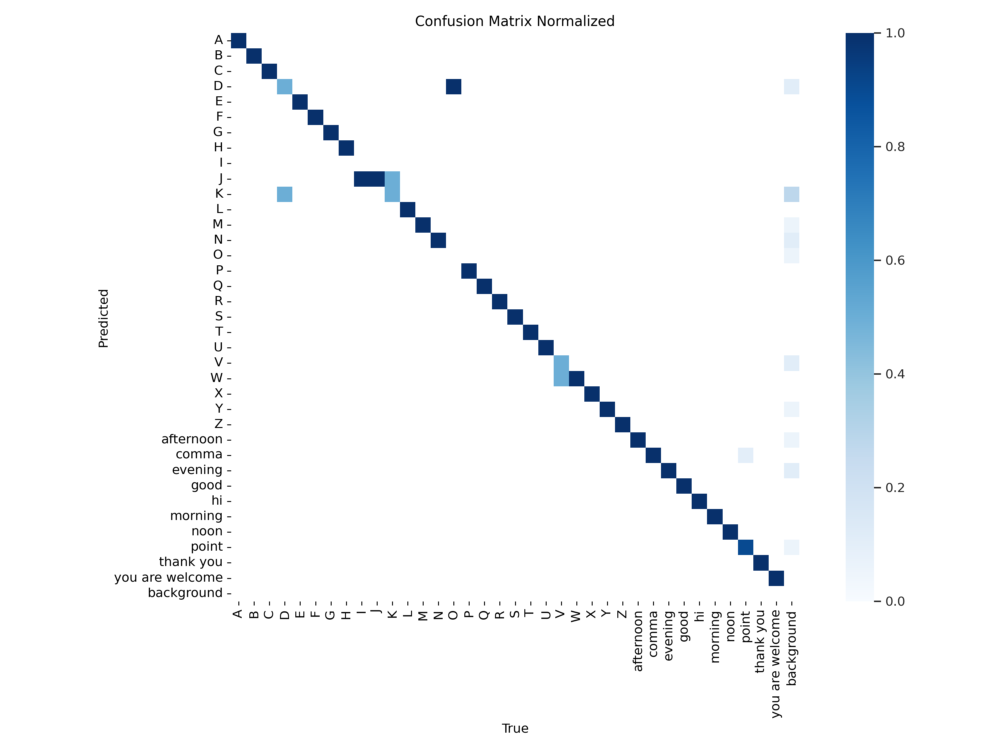

In [ ]:
from IPython.display import Image

# Specify the path to your image
image_path = '/content/runs/detect/train/confusion_matrix_normalized.png'

# Display the image
Image(filename=image_path)


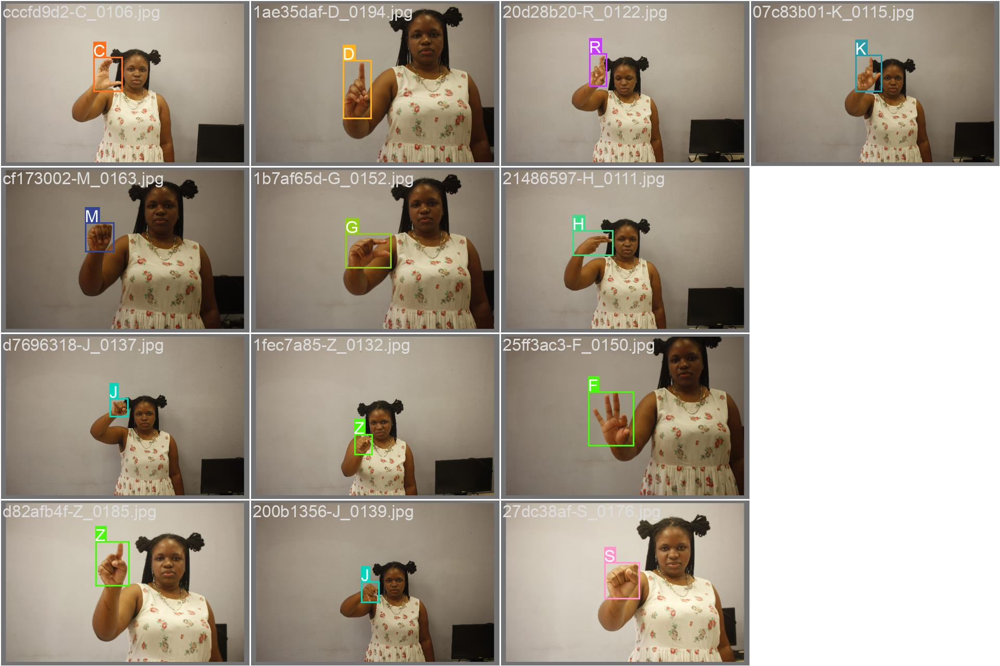

In [ ]:
from IPython.display import Image

# Specify the path to your image
image_path = '/content/runs/detect/train22/val_batch2_labels.jpg'

# Display the image
Image(filename=image_path)


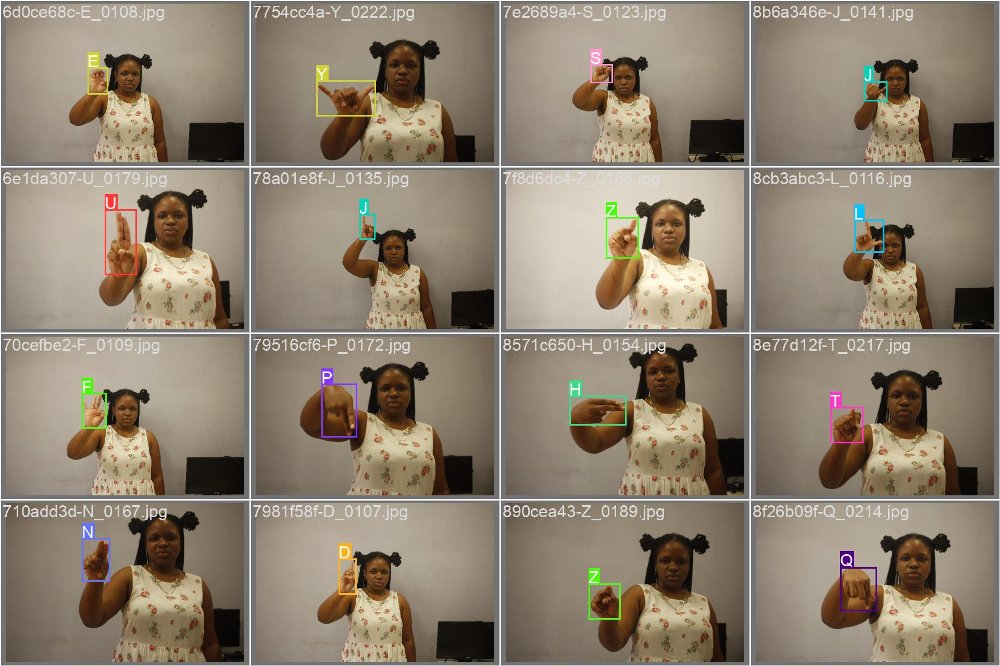

In [ ]:
# Specify the path to your image
image_path = '/content/runs/detect/train22/val_batch1_labels.jpg'

# Display the image
Image(filename=image_path)

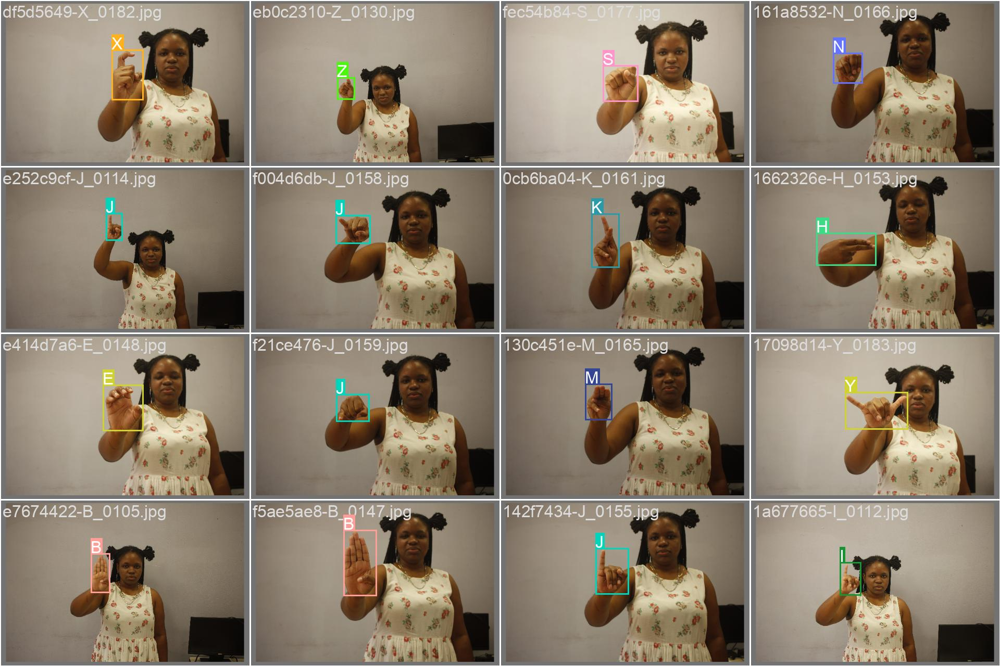

In [ ]:
# Specify the path to your image
image_path = '/content/runs/detect/train22/val_batch0_labels.jpg'

# Display the image
Image(filename=image_path)

In [1]:
from ultralytics import YOLO

In [2]:
model = YOLO("C:\\Users\\HP\\OneDrive\\Documents\\object-detection\\sign-language-detection\\models\\CustomModel_v1.pt")  # load a pretrained model (recommended for training)


image 1/1 /content/datasets/images/Afternoon_0924.jpg: 448x640 1 afternoon, 11.0ms
Speed: 4.0ms preprocess, 11.0ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


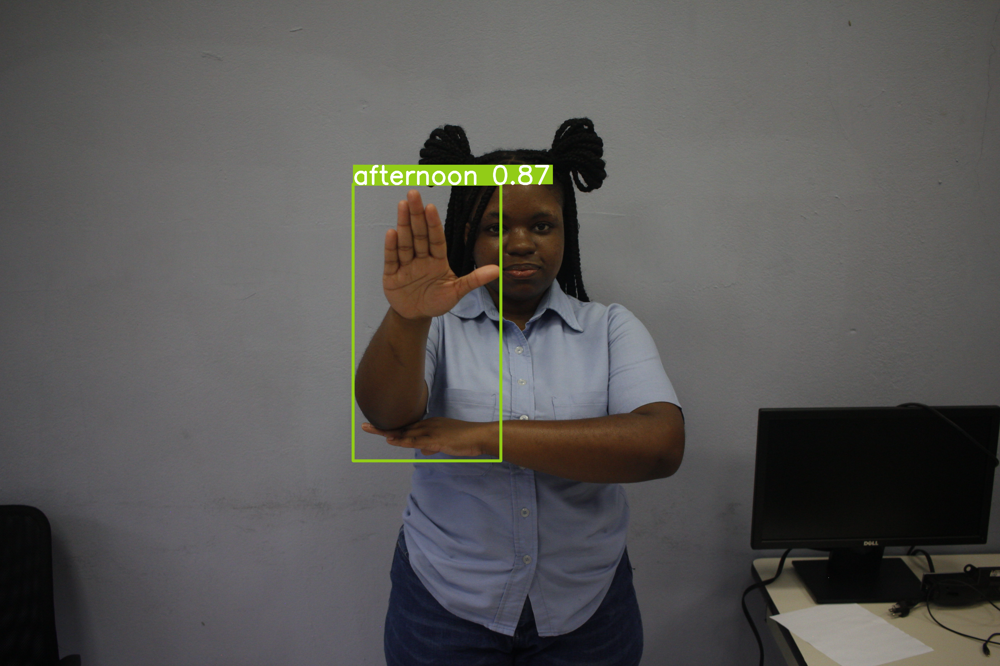

In [ ]:
from PIL import Image

results = model.predict(source="/content/datasets/images/Afternoon_0924.jpg")

for r in results:
    im_array = r.plot()  # plot a BGR numpy array of predictions
    im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
    display(im)  # show image

In [ ]:
import shutil

# Replace 'your_folder_path' with the actual path of the folder you want to zip
folder_path = '/content/runs'

# Replace 'output_zip_file.zip' with the desired name for the zip file
output_zip_file = '/content/runs'

shutil.make_archive(output_zip_file, 'zip', folder_path)


'/content/runs.zip'

In [3]:
import cv2
import numpy as np

In [4]:
results = model.predict(source=0,show=True)
results


1/1: 0... Success ✅ (inf frames of shape 640x480 at 30.00 FPS)


WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

0: 480x640 (no detections), 481.8ms
0: 480x640 1 C, 527.8ms
0: 480x640 1 C, 423.2ms
0: 480x640 1 C, 413.7ms
0: 480x640 1 C, 445.3ms
0: 480x640 (no detections), 452.1ms
0: 480x640 (no detections), 446.7ms
0: 480x640 (no detections), 450.0ms
0: 480x640 (no detections), 462.8ms
0: 480x640 (no detections), 445.0ms
0: 480x640 1 C, 480.2ms
0: 480x640 1 C, 477.0ms
0: 480x640 (no detections), 440.

KeyboardInterrupt: 

In [4]:
webcam = cv2.VideoCapture(0)
while webcam.isOpened():
    ret, frame = webcam.read()
    results = model(frame,stream=True)
    cv2.imshow('Feed',results)

    if cv2.waitKey(10) & 0xFF == ord('q'):
        break
webcam.release()
cv2.destroyAllWindows()

error: OpenCV(4.9.0) :-1: error: (-5:Bad argument) in function 'imshow'
> Overload resolution failed:
>  - mat is not a numpy array, neither a scalar
>  - Expected Ptr<cv::cuda::GpuMat> for argument 'mat'
>  - Expected Ptr<cv::UMat> for argument 'mat'


In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))

  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))